# Импорт библиотек

In [1]:
import os
import warnings

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

from collections import Counter

from tqdm.notebook import tqdm

from scipy.signal import savgol_filter

from sklearn.preprocessing import MinMaxScaler

from sklearn.metrics.cluster import v_measure_score
from sklearn.metrics import silhouette_score

from tslearn.clustering import TimeSeriesKMeans

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/tslearn/bases/bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


In [2]:
warnings.filterwarnings("ignore")

# Загрузка данных и их подготовка

In [3]:
path_ir = 'data/ftir'

path_to_curves = os.listdir(path_ir)
path_to_curves = sorted(path_to_curves, key=lambda x: int(x.split('.')[0]))
path_to_curves = [path_ir + '/' + filename for filename in path_to_curves]

ir_id = {}

for i, p in enumerate(path_to_curves):
    name = p.split('/')[-1].split('.')[0]
    ir_id[i] = name

In [4]:
def extract_ir_data(path):
    with open(path, 'r') as f:
        data = f.readlines()
        x_lst, y_lst = [], []
        for line in data:
            line = line.rstrip()
            x, y = map(float, line.split(','))
            x_lst.append(x)
            y_lst.append(y)
    return x_lst, y_lst

In [5]:
full_X = extract_ir_data(path_to_curves[0])[0]
X = list(filter(lambda x: x >= 800, full_X))

In [6]:
Y = [extract_ir_data(p)[1][:len(X)] for p in path_to_curves]  # initial

Y_smooth_only = [savgol_filter(y, window_length=53, polyorder=3) for y in Y]  # smoothed

scaler = MinMaxScaler()
Y_smooth = list(scaler.fit_transform(np.array(Y_smooth_only).T).T)  # smoothed and normalized to [0...1]

In [7]:
full_description = ['MFGO, разб. 1:20',
                    'HGO, 0.0116 г в 25 мл H2O',
                    'GO, RusGraphene, 2 г в 1000 мл H2O',
                    'rGO, 2 г в 1000 мл H2O',
                    'rGO, RusGraphene, 2 г в 1000 мл H2O',
                    'GO, RusGraphene, 2 г в 1000 мл H2O',
                    'GO, RusGraphene, 1.00 г в 250 мл H2O',
                    'rGO, RusGraphene, 0.20 г в 100 мл H2O',
                    'GO, RusGraphene, 1.00 г в 250 мл H2O',
                    'GO, USA, 0.1 г в 100 мл H2O',
                    'GO, RusGraphene, 2 г в 1000 мл H2O',
                    'Образец 8 после диализа 7 дней, H2O, стакан 1 л, замена воды каждые 2 дня',
                    'Образец 8 после диализа 7 дней, H2O, стакан 1 л, замена воды каждые 2 дня',
                    'Образец 8 после диализа 3.5 кДа, конд. 7 дней в H2O',
                    'Образец 8 после диализа 3.5 кДа, конд. 7 дней в ЭДТА 0.05 М',
                    'Образец 10 после диализа 3.5 кДа, конд. (rGO)',
                    'Образец 8 после диализа 3.5 кДа, конд. 7 дней в ЭДТА 0.05 М (повторное использование)',
                    'Образец 9 после диализа 14 кДа, конд. 7 дней в ЭДТА 0.05М',
                    'Образец 9 после диализа 14 кДа 75 мм, конд. 7 дней в ЭДТА 0.05М',
                    'Образец 9 после диализа 14 кДа 75 мм, конд. 7 дней в ЭДТА 0.05М (повторное использование)',
                    'Образец 11 после диализа 2 дня, H2O, 1 кДа',
                    'Образец 11 после диализа 5 дней, H2O, 14 кДа 75 мм',
                    'Образец 9 после диализа при 25°С 14 кДа, конд. 7 дней в ЭДТА 0.05М',
                    'Образец 9 после диализа при 45°С 14 кДа, конд. 7 дней в ЭДТА 0.05М',
                    'Образец 13 после диализа 0.5 кДа, конд. 7 дней в ЭДТА 0.05М',
                    'Образец 30 после диализа 12 дней, 14 кДа, конд. 7 дней в ЭДТА 0.05М']

short_desctiption = ['$GO$',
                     '$GO$',
                     '$GO$',
                     '$rGO$',
                     '$rGO$',
                     '$GO$',
                     '$GO$',
                     '$rGO$',
                     '$GO$',
                     '$GO$',
                     '$GO$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$rGO$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$',
                     '$GO_{d}$']

class_lst = list(map(lambda x: 0 if x == '$rGO$' else 1 if x == '$GO$' else 2, short_desctiption))

In [14]:
data = pd.DataFrame({ir_id[i]: pd.Series(Y_smooth[i]) for i in range(len(Y_smooth))})  # creating dataframe
data = data.T  # transposition

data.insert(loc=0, column='full_descr', value=full_description)
data.insert(loc=0, column='short_descr', value=short_desctiption)
data.insert(loc=0, column='class', value=class_lst)
# data

In [15]:
data_spectra = data.iloc[:, 3:]
# data_spectra

# Аугментация

In [17]:
aug_data = data.copy()

aug_factor = 20
min_sigma = 5e-3
max_sigma = 1e-1

for i in range(len(Y_smooth)):
    st_dev_values = np.linspace(min_sigma, max_sigma, aug_factor)
    for j in st_dev_values:
        Y_aug = aug_data.iloc[i, 3:] + np.random.normal(0, j, aug_data.iloc[i, 3:].shape[0])
        scaler = MinMaxScaler()
        Y_aug = scaler.fit_transform(np.array(Y_aug).reshape(-1, 1)).T[0]
        row = list(aug_data.iloc[i, :3]) + list(Y_aug)
        aug_data.loc[aug_data.shape[0]] = row
aug_data

,class,short_descr,full_descr,0,1,2,3,4,5,6,...,1132,1133,1134,1135,1136,1137,1138,1139,1140,1141
1,1,$GO$,"MFGO, разб. 1:20",0.000640,0.001004,0.001344,0.001663,0.001963,0.002249,0.002523,...,0.015380,0.014461,0.013624,0.012871,0.012207,0.011634,0.011156,0.010776,0.010497,0.010321
2,1,$GO$,"HGO, 0.0116 г в 25 мл H2O",0.002861,0.002418,0.002016,0.001654,0.001331,0.001046,0.000797,...,0.044618,0.042554,0.040512,0.038498,0.036518,0.034578,0.032683,0.030841,0.029057,0.027337
3,1,$GO$,"GO, RusGraphene, 2 г в 1000 мл H2O",0.001163,0.001654,0.002071,0.002418,0.002698,0.002916,0.003075,...,0.173272,0.171406,0.169601,0.167860,0.166185,0.164578,0.163042,0.161579,0.160192,0.158883
5,0,$rGO$,"rGO, 2 г в 1000 мл H2O",0.014814,0.014902,0.014974,0.015029,0.015068,0.015091,0.015099,...,0.226406,0.227242,0.228139,0.229101,0.230130,0.231226,0.232393,0.233631,0.234944,0.236332
6,0,$rGO$,"rGO, RusGraphene, 2 г в 1000 мл H2O",0.049099,0.049846,0.050428,0.050851,0.051123,0.051250,0.051241,...,0.359760,0.358619,0.357471,0.356319,0.355164,0.354008,0.352854,0.351701,0.350554,0.349412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
541,2,$GO_{d}$,"Образец 30 после диализа 12 дней, 14 кДа, конд...",0.218988,0.101642,0.049759,0.187927,0.117456,0.028313,0.084692,...,0.141252,0.141564,0.245844,0.232497,0.187039,0.314224,0.148796,0.195276,0.160900,0.070489
542,2,$GO_{d}$,"Образец 30 после диализа 12 дней, 14 кДа, конд...",0.272893,0.273834,0.177490,0.186913,0.096652,0.045233,0.130319,...,0.177836,0.114529,0.123914,0.193542,0.317913,0.361853,0.253021,0.256463,0.118522,0.248900
543,2,$GO_{d}$,"Образец 30 после диализа 12 дней, 14 кДа, конд...",0.189939,0.149964,0.088709,0.145053,0.142038,0.147499,0.245626,...,0.357831,0.172104,0.304362,0.205668,0.210013,0.292909,0.303633,0.242605,0.146714,0.235023
544,2,$GO_{d}$,"Образец 30 после диализа 12 дней, 14 кДа, конд...",0.075619,0.150973,0.153012,0.068646,0.260718,0.151774,0.132440,...,0.198717,0.211570,0.165224,0.251092,0.193249,0.185526,0.184408,0.061068,0.227811,0.222177


In [18]:
descr_aug_data = aug_data.iloc[:, :2]
clust_aug_data = aug_data.iloc[:, 3:]

# Кластерный анализ

## Основные функции для кластеризации

In [76]:
def plot_v_measure(data,
                   targets,
                   max_clusters=10,
                   metric='euclidean',
                   save='n',
                   name_of_file='f',
                   style='default',
                   title='',
                   figsize=(16, 5),
                   dpi=300):
    
    figure_templ = [['middle']]
    fig, ax = plt.subplot_mosaic(figure_templ,
                                 gridspec_kw={'width_ratios': [1]},
                                 figsize=figsize,
                                 dpi=dpi,
                                 layout='constrained')
    
    v_measure = []
    clusters_range = range(1, max_clusters)
                     
    for k in tqdm(clusters_range):
        kmeans = TimeSeriesKMeans(n_clusters=k,
                                  metric=metric,
                                  n_jobs=25,
                                  max_iter=100_000,
                                  random_state=42)
        kmeans.fit(data)
        
        # v-measure
        groups = kmeans.fit_predict(data)
        v_measure.append(v_measure_score(groups, targets))
    
    max_v_measure = round(max(v_measure), 3)
    mean_v_measure = round(np.mean(v_measure), 3)
    
    # V-measure Plot
    ax['middle'].grid(True)
    ax['middle'].tick_params(direction='in')
    
    if title:
        ax['middle'].set_title(f'{title}',
                               fontname='DejaVu Sans',
                               fontsize=16,
                               fontstyle='italic',
                               fontweight='heavy')
    
    ax['middle'].plot(clusters_range,
                      v_measure,
                      '-o',
                      color='orange')
    
#     ax['middle'].plot([], [], ' ', label='$\overline{V}$' + f'= {mean_v_measure}')
    ax['middle'].plot([], [], ' ', label='$V_{max}$' + f'= {max_v_measure}')
    
    ax['middle'].set_xlabel('$Number$ $of$ $clusters$',
                            fontname='DejaVu Sans',
                            fontsize=14
                           )
    ax['middle'].set_ylabel('$V$',
                            fontname='DejaVu Sans',
                            fontsize=14
                           )
    ax['middle'].legend(fancybox=True,
                        shadow=True,
                        loc='lower right',
                        prop={'size': 16}
                       )
    
    fig.tight_layout()
    if save in ['y', 'Y', 'yes']:
        plt.savefig(name_of_file, dpi=dpi)
    plt.show()

In [77]:
def plot_metrics(data,
                 targets=[],
                 max_clusters=10,
                 metric='euclidean',
                 figsize=(16, 9),
                 save='n',
                 name_of_file='f',
                 style='default',
                 dpi=300):
    if targets:
        figure_templ = [['left', 'middle', 'right']]
        gridspec_kw = {'width_ratios': [1, 1, 1]}
    else:
        figure_templ = [['left', 'right']]
        gridspec_kw = {'width_ratios': [1, 1]}
    
    fig, ax = plt.subplot_mosaic(figure_templ,
                                 gridspec_kw=gridspec_kw,
                                 figsize=figsize,
                                 dpi=dpi,
                                 layout='constrained')

    inertia = []
    silhouette = []
    if targets:
        v_measure = []
    clusters_range = range(1, max_clusters)

    for k in tqdm(clusters_range):
        kmeans = TimeSeriesKMeans(n_clusters=k,
                                  metric=metric,
                                  n_jobs=25,
                                  max_iter=100_000,
                                  random_state=42)
        kmeans.fit(data)
        
        # inertia
        inertia.append(kmeans.inertia_)
        
        # v-measure
        groups = kmeans.fit_predict(data)
        if targets:
            v_measure.append(v_measure_score(groups, targets))
        
        # silhouette-score
        if k >= 2:
            silhouette.append(silhouette_score(data, kmeans.labels_))
    
    max_v_measure = round(max(v_measure), 3)
    mean_v_measure = round(np.mean(v_measure), 4)


    # Inertia Plot
    ax['left'].grid(True)
    ax['left'].tick_params(direction='in')
    ax['left'].set_title(f'Elbow method',
                         fontname='DejaVu Sans',
                         fontsize=20,
                         fontstyle='italic',
                         fontweight='heavy')
    ax['left'].plot(clusters_range,
                    inertia,
                    '-o',
                    linewidth=2.0,
                    color='orange')
    ax['left'].set_xlabel('$Number$ $of$ $clusters$',
                          fontname='DejaVu Sans',
                          fontsize=16)
    ax['left'].set_ylabel('$WCSS$',
                          fontname='DejaVu Sans',
                          fontsize=16)

    # V-measure Plot
    if targets:
        ax['middle'].grid(True)
        ax['middle'].tick_params(direction='in')
        ax['middle'].set_title(f'V-measure',
                               fontname='DejaVu Sans',
                               fontsize=20,
                               fontstyle='italic',
                               fontweight='heavy')
        ax['middle'].plot(clusters_range,
                          v_measure,
                          '-o',
                          color='orange')
        ax['middle'].plot([], [], ' ', label='$V_{max}$' + f'= {max_v_measure}')
        ax['middle'].set_xlabel('$Number$ $of$ $clusters$',
                                fontname='DejaVu Sans',
                                fontsize=16)
        ax['middle'].set_ylabel('$V$',
                                fontname='DejaVu Sans',
                                fontsize=16)
        ax['middle'].legend(fancybox=True,
                            shadow=True,
                            loc='best',
                            prop={'size': 20})
    else:
        pass
    
    # Silhouette-score Plot
    ax['right'].grid(True)
    ax['right'].tick_params(direction='in')
    ax['right'].set_title(f'Silhouette score',
                          fontname='DejaVu Sans',
                          fontsize=20,
                          fontstyle='italic',
                          fontweight='heavy')
    ax['right'].plot(clusters_range[1:],
                     silhouette,
                     '-o',
                     linewidth=2.0,
                     color='orange')
    ax['right'].set_xlabel('$Number$ $of$ $clusters$',
                           fontname='DejaVu Sans',
                           fontsize=16)
    ax['right'].set_ylabel('$SS$',
                           fontname='DejaVu Sans',
                           fontsize=16)

    fig.tight_layout()
    if save in ['y', 'Y', 'yes']:
        plt.savefig(name_of_file, dpi=dpi)
    plt.show()

In [78]:
def plot_centroids(data,
                   n_clusters=3,
                   metric='euclidean',
                   figsize=(16, 9),
                   save='n',
                   name_of_file='f',
                   style='default',
                   dpi=300):
    ts_kmeans = TimeSeriesKMeans(n_clusters=n_clusters,
                                 metric=metric,
                                 n_jobs=-1,
                                 max_iter=10_000,
                                 random_state=42)
    ts_kmeans.fit_predict(data)
    mpl.style.use(style)
    fig = plt.figure(figsize=figsize, dpi=dpi)
    ax = fig.gca()
    ax.grid(True)
    ax.tick_params(direction='in')
    ax.set_title(f'Centroids of clusters',
                 fontname='DejaVu Sans',
                 fontsize=20,
                 fontstyle='italic',
                 fontweight='heavy')

    colors = ['red', 'blue', 'green', 'orange', 'purple', 'black', 'crimson', 'slategrey', 'olive', 'lightpink']
    colors = colors[:n_clusters]
    for i in tqdm(range(n_clusters)):
        ax.plot(X,
                ts_kmeans.cluster_centers_[i, :, 0].T,
                color=colors[i],
                linewidth=2.0,
                label=f'${i+1}$')

        ax.set_xlabel('$λ^{-1}, cm^{-1}$',
                      fontname='DejaVu Sans',
                      fontsize=16)
        ax.set_ylabel('$A_{n}$',
                      fontname='DejaVu Sans',
                      fontsize=16,
                      rotation=0,
                      labelpad=15)
        ax.legend(title='$Centroid$ $of$ $cluster$',
                  fancybox=True,
                  shadow=True,
                  prop={'size': 12}).get_title().set_fontsize('14')
        
    plt.gca().invert_xaxis()

    plt.tight_layout()
    
    if save in ['y', 'Y', 'yes']:
        plt.savefig(name_of_file, dpi=dpi)
    plt.show()
#     return ts_kmeans.cluster_centers_.T

In [79]:
def ts_cluster_analysis(data,
                        info=[],
                        n_clusters=3,
                        metric='euclidean',
                        save='n',
                        name_of_file='f',
                        dpi=150,
                        show='n'):
    
    clust_data = data.copy()

    ts_kmeans = TimeSeriesKMeans(n_clusters=n_clusters,
                                 metric=metric,
                                 n_jobs=-1,
                                 max_iter=10_000,
                                 random_state=42)
    cluster_labels = ts_kmeans.fit_predict(clust_data)
    clust_data.insert(loc=0, column='cluster_label', value=cluster_labels)
    
    clust_info = info.copy()
    if not clust_info.empty:
        clust_info.insert(loc=0, column='cluster_label', value=cluster_labels)
        clust_info['cluster_label'] += 1
        clust_info = clust_info.sort_values(by='cluster_label')
        clust_info.to_excel(name_of_file + '.xlsx',
                            index=False,
                            encoding='utf-8-sig')
        
        for i in clust_info['cluster_label'].unique():
            part_of_df = clust_info.loc[clust_info['cluster_label'] == i]
            dict_of_freq = Counter(list(part_of_df['class']))
            n = sum(list(dict_of_freq.values()))
            for key in dict_of_freq.keys():
                dict_of_freq[key] = round(dict_of_freq[key] / n, 4)
            print(f'Кластер №{i}: {dict(dict_of_freq)}')
    else:
        pass
    
    if show in ['n', 'N', 'No', 'no', 'NO']:
        pass
    else:
        for cluster_label in tqdm(range(n_clusters)):
            rows_indexes = ['Центроида'] + list(clust_data[clust_data['cluster_label'] == cluster_label].index)
            num_of_elements = len(rows_indexes)
            nrows = num_of_elements // 3 if num_of_elements % 3 == 0 else num_of_elements // 3 + 1
            ncols = 3 * 2

            ncol_index = 0
            flag = 0

            mpl.style.use(style)  # default, ggplot, seaborn-v0_8
            width = 16
            heigth = 4.5 * nrows
            fig = plt.figure(figsize=(width, heigth), dpi=dpi)
            grid = plt.GridSpec(nrows=nrows, ncols=ncols)

            fig.suptitle(t=f'Кластер №{cluster_label+1}',
                         x=0.525,
                         fontname='DejaVu Sans',
                         fontsize=28,
                         fontstyle='italic',
                         fontweight='heavy')

            for i, row in enumerate(rows_indexes):
                if i == 0:
                    y = ts_kmeans.cluster_centers_[0, :, 0].T
                    color='blue'
                else:
                    y = clust_data[clust_data['cluster_label'] == cluster_label].loc[[row]].iloc[:, 1:].values[0]
                    color = 'red'
                nrow_index = i // 3

                if (nrow_index == nrows - 1) and (num_of_elements % 3 != 0) and (flag == 0):
                    if num_of_elements % 3 == 1:
                        ncol_index = 2
                    elif num_of_elements % 3 == 2:
                        ncol_index = 1
                    flag = 1

                plt.subplot(grid[nrow_index, ncol_index:ncol_index+2])
                plt.grid(True)
                plt.tick_params(direction='in')
                ax = fig.gca()
                ax.set_title(row,
                             fontname='DejaVu Sans',
                             fontsize=20,
                             fontweight='light',
                             color='black')
                ax.plot(X,
                        y,
                        color=color,
                        markerfacecolor='black',
                        linewidth=1.5)

            #     ax.spines['top'].set_color('black')
            #     ax.spines['bottom'].set_color('black')
            #     ax.spines['left'].set_color('black')
            #     ax.spines['right'].set_color('black')

                ax.set_xlabel('$λ^{-1}, см^{-1}$',
                              fontname='DejaVu Sans',
                              fontsize=16)
                ax.set_ylabel('$A$',
                              fontname='DejaVu Sans',
                              fontsize=16,
                              rotation=0,
                              labelpad=15)
                plt.gca().invert_xaxis()

                if ncol_index == 4:
                    ncol_index = 0
                else:
                    ncol_index += 2

            fig.tight_layout(pad=1/3 * nrows + 1/3)
            if save in ['y', 'Y', 'yes']:
                plt.savefig(name_of_file + f'_{cluster_label+1}')
                distribution_df.to_excel(name_of_file + '.xlsx',
                             index=False)
            plt.show()
    return clust_info

## Расчет V-меры

  0%|          | 0/9 [00:00<?, ?it/s]

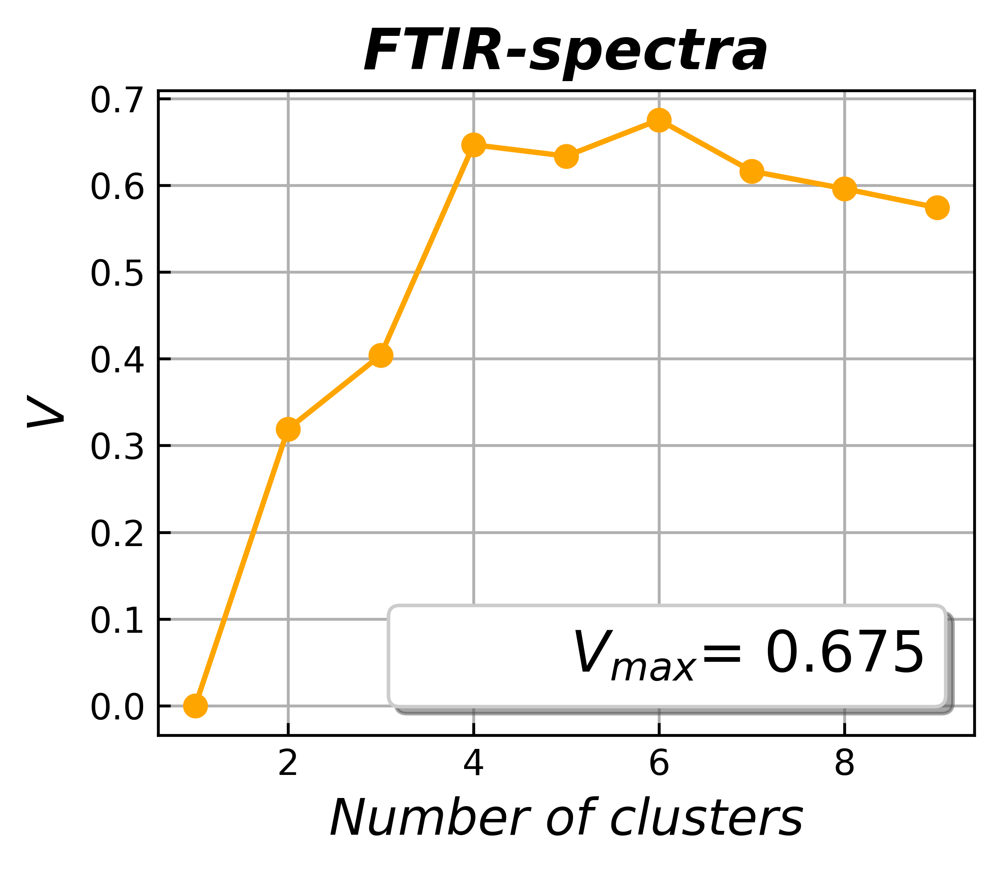

In [32]:
# Метрика Euclidean

path_to_save = 'results/ftir/step1/euclidean'

for data, name, title in zip([data_spectra],
                             ['spectra'],
                             ['FTIR-spectra']):
    calculate_v_measure(data=data,
                        targets=class_lst,
                        max_clusters=10,
                        metric='euclidean',
                        save='y',
                        title=title,
                        figsize=(4, 3.5),
                        name_of_file=path_to_save + f'/v_measure_{name}_eucl.png', 
                        dpi=600)

  0%|          | 0/9 [00:00<?, ?it/s]

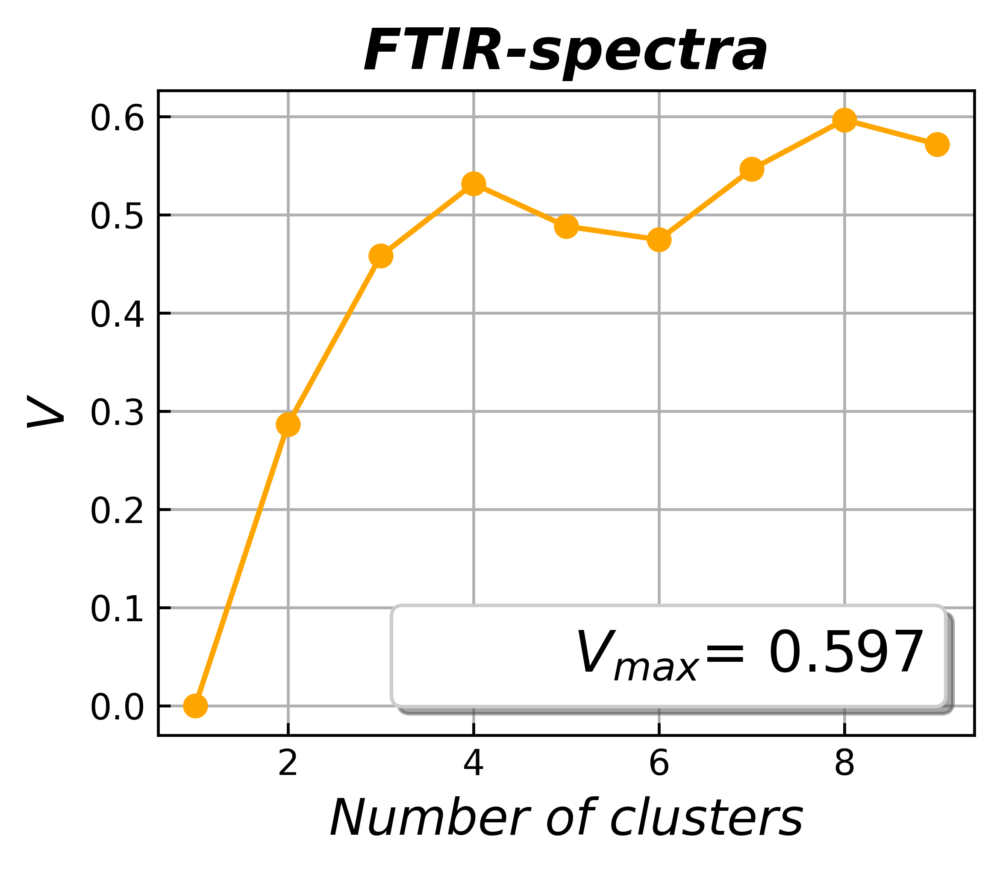

In [34]:
# Метрика DTW

path_to_save = 'results/ftir/step1/dtw'

for data, name, title in zip([data_spectra],
                             ['spectra'],
                             ['FTIR-spectra']):
    calculate_v_measure(data=data,
                        targets=class_lst,
                        max_clusters=10,
                        metric='dtw',
                        save='y',
                        title=title,
                        figsize=(4, 3.5),
                        name_of_file=path_to_save + f'/v_measure_{name}_eucl.png', 
                        dpi=600)

## Евклидова метрика

In [43]:
path_to_save = 'results/ftir/step1/euclidean'

### Оценка числа кластеров

  0%|          | 0/10 [00:00<?, ?it/s]

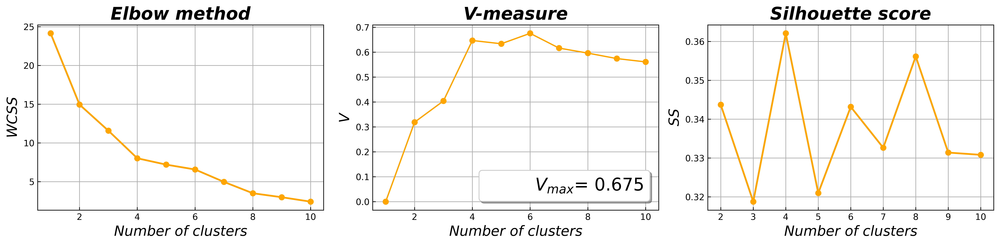

In [67]:
plot_metrics(data=data_spectra,
             targets=class_lst,
             max_clusters=11,
             metric='euclidean',
             figsize=(16, 4),
             save='y',
             name_of_file=path_to_save + '/eucl_metrics',
             style='default',
             dpi=600)

### Число кластеров — 3

  0%|          | 0/3 [00:00<?, ?it/s]

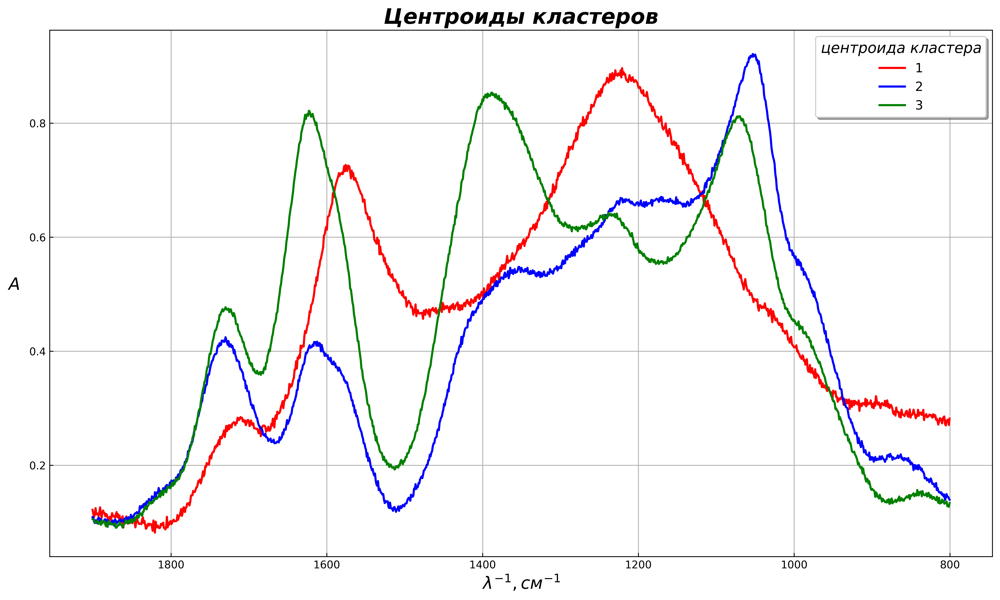

In [231]:
plot_centroids(data=clust_data,
               n_clusters=3,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/4_clusters/eucl_centroids_4',
               style='default',
               dpi=600)

In [232]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=3,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/3_clusters/clust_3',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {1: 0.7778, 2: 0.2222}
Кластер №3: {2: 0.9231, 1: 0.0769}


,cluster_label,class,short_descr
91,1,0,$rGO$
113,1,0,$rGO$
112,1,0,$rGO$
111,1,0,$rGO$
110,1,0,$rGO$
...,...,...,...
355,3,2,$GO_{d}$
354,3,2,$GO_{d}$
353,3,2,$GO_{d}$
359,3,2,$GO_{d}$


### Число кластеров — 4

  0%|          | 0/4 [00:00<?, ?it/s]

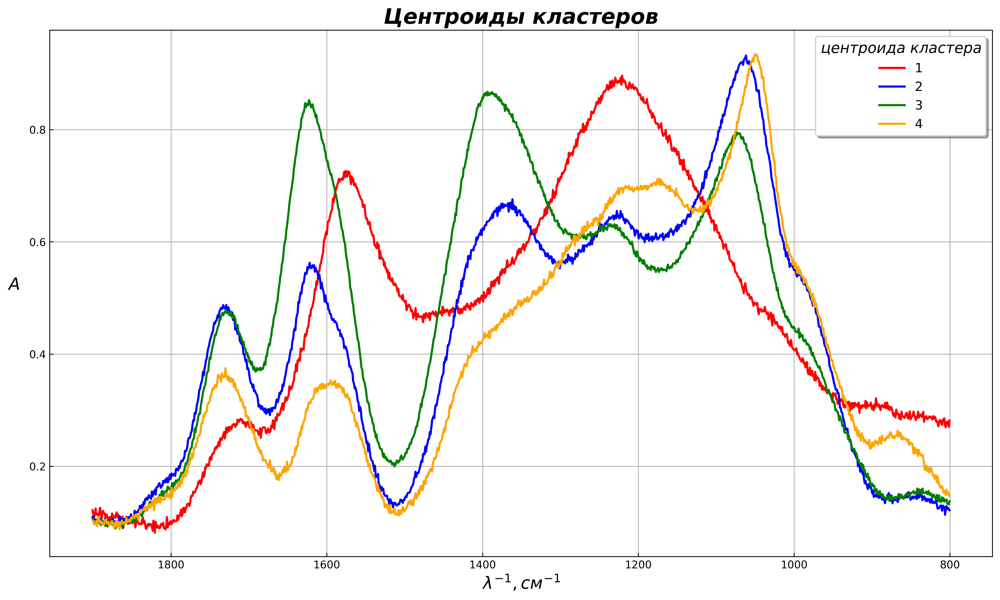

In [233]:
plot_centroids(data=clust_data,
               n_clusters=4,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/4_clusters/eucl_centroids_4',
               style='default',
               dpi=600)

In [234]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=4,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/4_clusters/clust_4',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {1: 0.3471, 2: 0.6529}
Кластер №3: {2: 0.911, 1: 0.089}
Кластер №4: {1: 1.0}


,cluster_label,class,short_descr
89,1,0,$rGO$
111,1,0,$rGO$
110,1,0,$rGO$
109,1,0,$rGO$
108,1,0,$rGO$
...,...,...,...
130,4,1,$GO$
129,4,1,$GO$
128,4,1,$GO$
3,4,1,$GO$


### Число кластеров — 5

  0%|          | 0/5 [00:00<?, ?it/s]

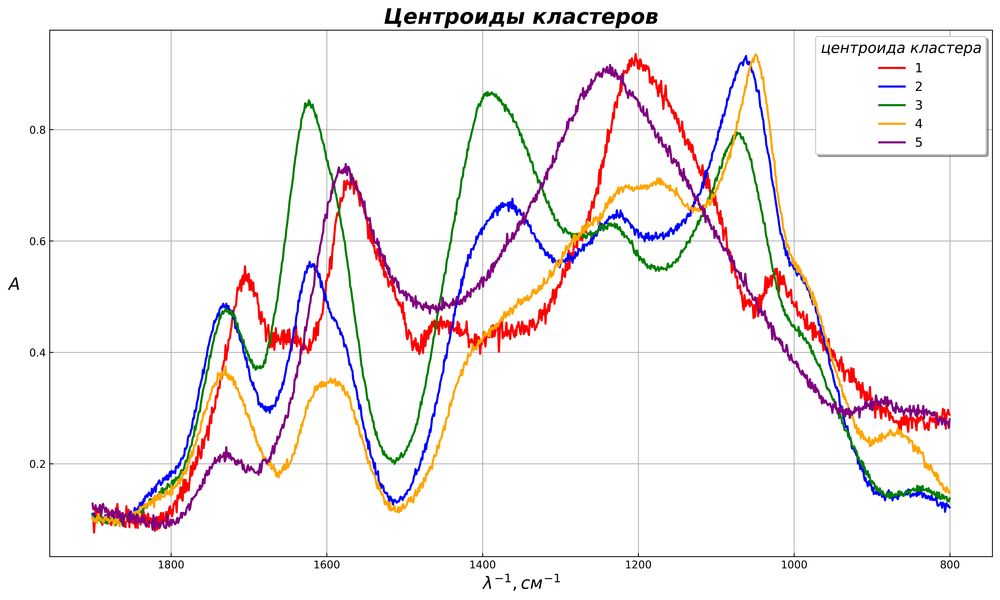

In [235]:
plot_centroids(data=clust_data,
               n_clusters=5,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/5_clusters/eucl_centroids_5',
               style='default',
               dpi=600)

In [236]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=5,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/5_clusters/clust_5',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {2: 0.6529, 1: 0.3471}
Кластер №3: {2: 0.911, 1: 0.089}
Кластер №4: {1: 1.0}
Кластер №5: {0: 1.0}


,cluster_label,class,short_descr
87,1,0,$rGO$
86,1,0,$rGO$
88,1,0,$rGO$
89,1,0,$rGO$
90,1,0,$rGO$
...,...,...,...
110,5,0,$rGO$
111,5,0,$rGO$
112,5,0,$rGO$
332,5,0,$rGO$


### Число кластеров — 6

  0%|          | 0/6 [00:00<?, ?it/s]

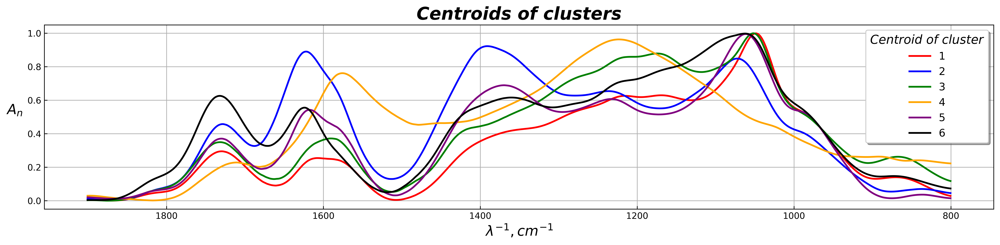

In [68]:
plot_centroids(data=data_spectra,
               n_clusters=6,
               metric='euclidean',
               figsize=(16, 4),
               save='y',
               name_of_file=path_to_save + '/6_clusters/eucl_centroids_6',
               style='default',
               dpi=600)

In [238]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=6,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/6_clusters/clust_6',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {1: 0.3925, 2: 0.6075}
Кластер №3: {2: 0.8941, 1: 0.1059}
Кластер №4: {1: 1.0}
Кластер №5: {0: 1.0}
Кластер №6: {2: 0.9625, 1: 0.0375}


,cluster_label,class,short_descr
102,1,0,$rGO$
105,1,0,$rGO$
104,1,0,$rGO$
103,1,0,$rGO$
86,1,0,$rGO$
...,...,...,...
30,6,2,$GO_{d}$
425,6,2,$GO_{d}$
424,6,2,$GO_{d}$
422,6,2,$GO_{d}$


### Число кластеров — 7

  0%|          | 0/7 [00:00<?, ?it/s]

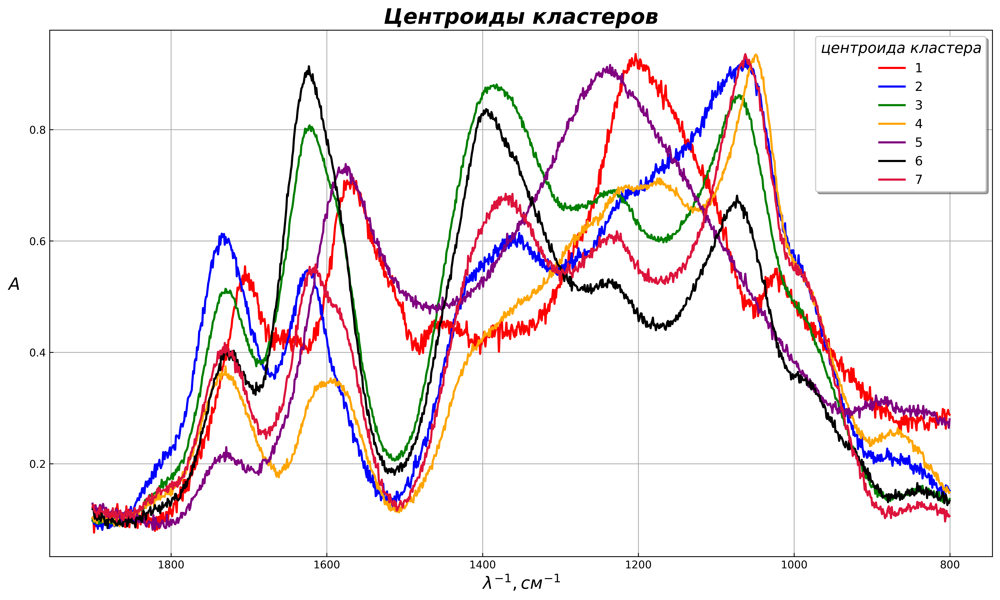

In [239]:
plot_centroids(data=clust_data,
               n_clusters=7,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/7_clusters/eucl_centroids_7',
               style='default',
               dpi=600)

In [240]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=7,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/7_clusters/clust_7',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {1: 1.0}
Кластер №3: {2: 0.8844, 1: 0.1156}
Кластер №4: {1: 1.0}
Кластер №5: {0: 1.0}
Кластер №6: {2: 0.9872, 1: 0.0128}
Кластер №7: {2: 1.0}


,cluster_label,class,short_descr
103,1,0,$rGO$
101,1,0,$rGO$
100,1,0,$rGO$
99,1,0,$rGO$
98,1,0,$rGO$
...,...,...,...
440,7,2,$GO_{d}$
441,7,2,$GO_{d}$
442,7,2,$GO_{d}$
448,7,2,$GO_{d}$


### Число кластеров — 8

  0%|          | 0/8 [00:00<?, ?it/s]

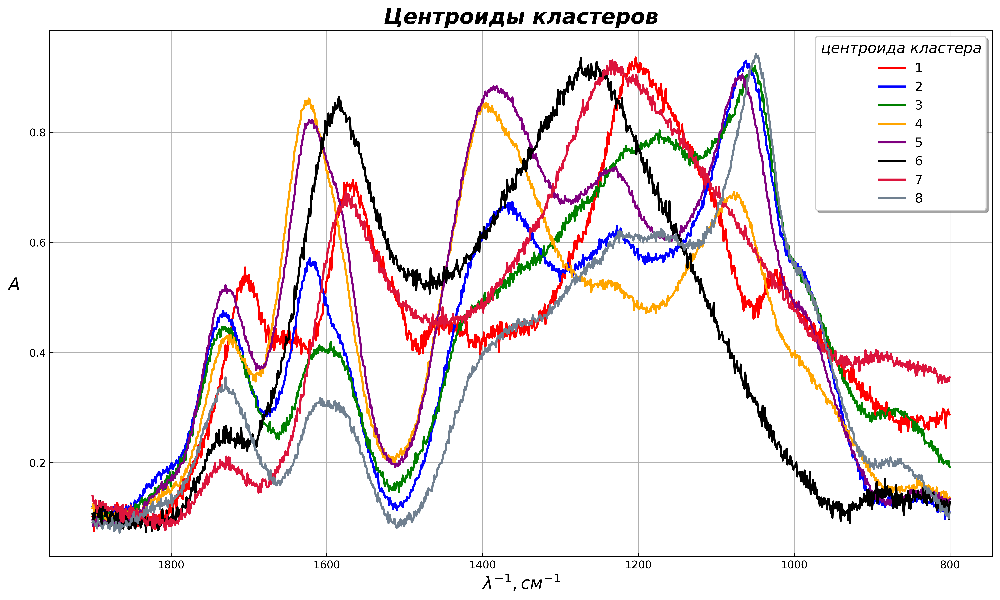

In [241]:
plot_centroids(data=clust_data,
               n_clusters=8,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/8_clusters/eucl_centroids_8',
               style='default',
               dpi=600)

In [242]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=8,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/8_clusters/clust_8',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {2: 0.75, 1: 0.25}
Кластер №3: {1: 1.0}
Кластер №4: {1: 0.1754, 2: 0.8246}
Кластер №5: {2: 0.9926, 1: 0.0074}
Кластер №6: {0: 1.0}
Кластер №7: {0: 1.0}
Кластер №8: {1: 0.9655, 2: 0.0345}


,cluster_label,class,short_descr
86,1,0,$rGO$
105,1,0,$rGO$
104,1,0,$rGO$
103,1,0,$rGO$
102,1,0,$rGO$
...,...,...,...
161,8,1,$GO$
162,8,1,$GO$
163,8,1,$GO$
202,8,1,$GO$


### Число кластеров — 9

  0%|          | 0/9 [00:00<?, ?it/s]

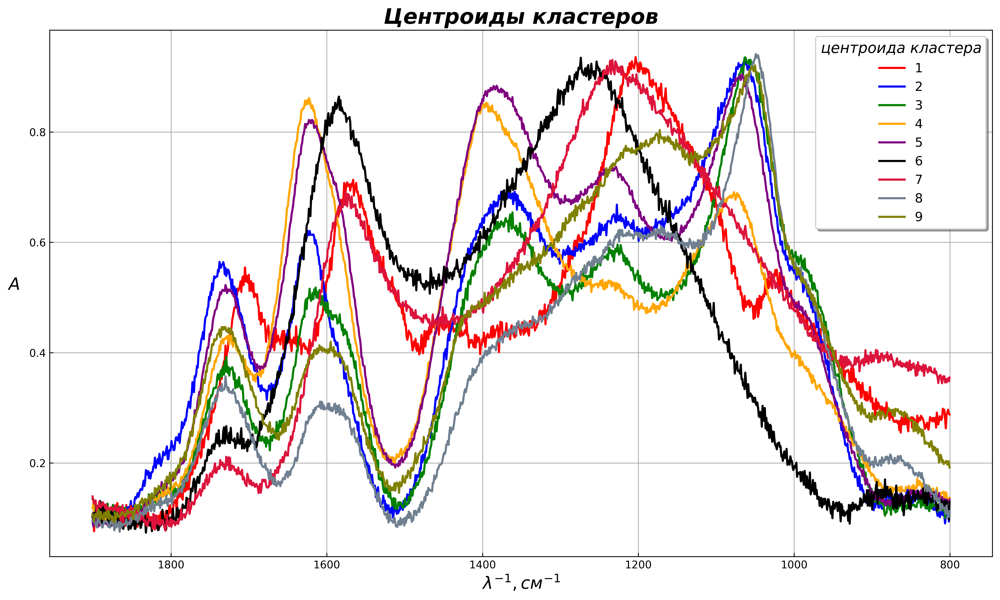

In [243]:
plot_centroids(data=clust_data,
               n_clusters=9,
               metric='euclidean',
               save='y',
               name_of_file=path_to_save + '/9_clusters/eucl_centroids_9',
               style='default',
               dpi=600)

In [244]:
# %%time
ts_cluster_analysis(data=clust_data,
                    info=descr_data,
                    n_clusters=9,
                    metric='euclidean',
                    save='y',
                    name_of_file=path_to_save + '/9_clusters/clust_9',
                    dpi=600,
                    show='n')

Кластер №1: {0: 1.0}
Кластер №2: {1: 0.4773, 2: 0.5227}
Кластер №3: {2: 1.0}
Кластер №4: {1: 0.1754, 2: 0.8246}
Кластер №5: {2: 0.9926, 1: 0.0074}
Кластер №6: {0: 1.0}
Кластер №7: {0: 1.0}
Кластер №8: {1: 1.0}
Кластер №9: {1: 1.0}


,cluster_label,class,short_descr
103,1,0,$rGO$
102,1,0,$rGO$
105,1,0,$rGO$
104,1,0,$rGO$
86,1,0,$rGO$
...,...,...,...
230,9,1,$GO$
231,9,1,$GO$
232,9,1,$GO$
3,9,1,$GO$


## Метрика DTW

In [80]:
path_to_save = 'results/ftir/step1/dtw'

### Оценка числа кластеров

  0%|          | 0/10 [00:00<?, ?it/s]

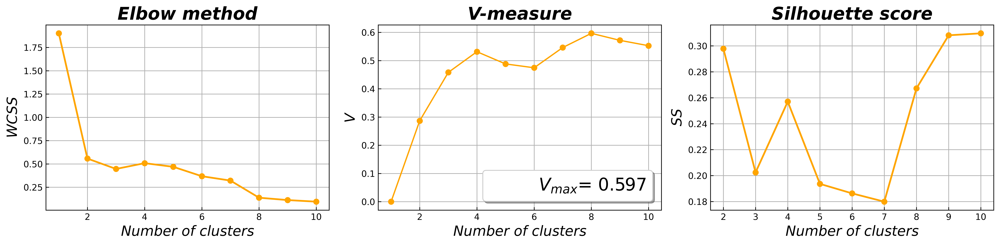

In [81]:
plot_metrics(data=data_spectra,
             targets=class_lst,
             max_clusters=11,
             metric='dtw',
             figsize=(16, 4),
             save='y',
             name_of_file=path_to_save + '/dtw_metrics',
             style='default',
             dpi=600)

### Число кластеров — 3

(26, 1142)
я тут


  0%|          | 0/3 [00:00<?, ?it/s]

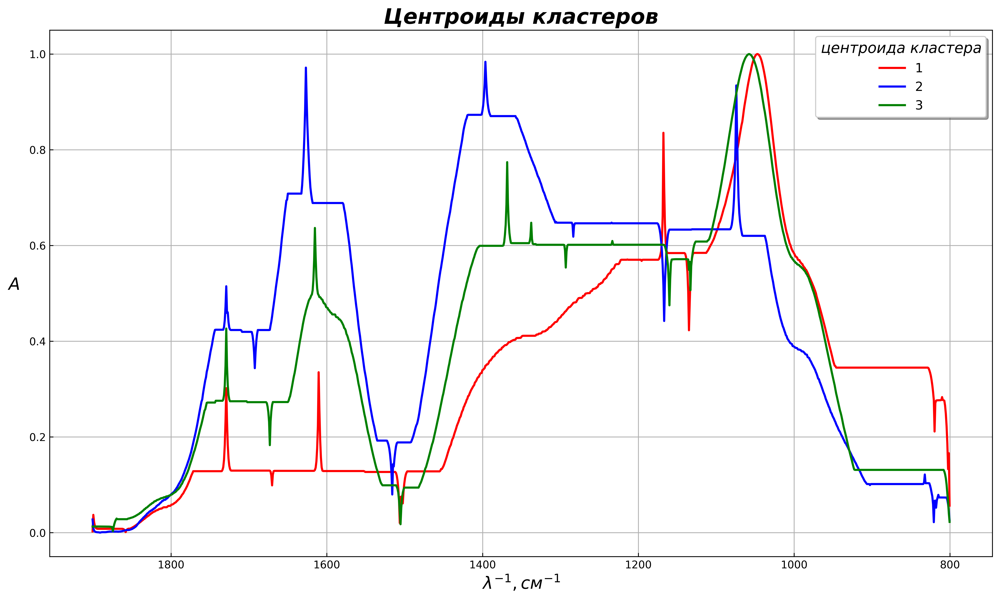

In [256]:
plot_centroids(data=clust_data_dtw,
               n_clusters=3,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/3_clusters/dtw_centroids_3',
               style='default',
               dpi=600)

In [261]:
%%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=3,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/3_clusters/clust_3',
                    dpi=600,
                    show='n')

Кластер №1: {1: 0.5556, 0: 0.4444}
Кластер №2: {2: 0.9091, 1: 0.0909}
Кластер №3: {2: 0.6667, 1: 0.3333}
CPU times: user 52.9 s, sys: 12.3 s, total: 1min 5s
Wall time: 43.4 s


,cluster_label,class,short_descr
13,1,1,$GO$
3,1,1,$GO$
5,1,0,$rGO$
6,1,0,$rGO$
8,1,1,$GO$
9,1,1,$GO$
10,1,0,$rGO$
11,1,1,$GO$
21,1,0,$rGO$
24,2,2,$GO_{d}$


### Число кластеров — 4

  0%|          | 0/4 [00:00<?, ?it/s]

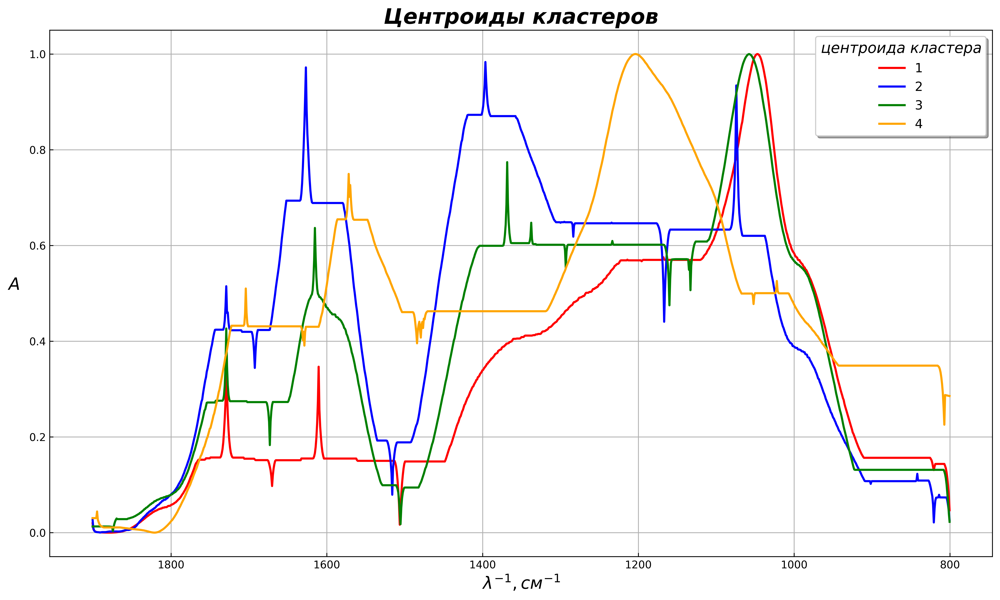

In [262]:
plot_centroids(data=clust_data_dtw,
               n_clusters=4,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/4_clusters/dtw_centroids_4',
               style='default',
               dpi=600)

In [263]:
# %%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=4,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/4_clusters/clust_4',
                    dpi=600,
                    show='n')

Кластер №1: {1: 0.8333, 0: 0.1667}
Кластер №2: {2: 0.9091, 1: 0.0909}
Кластер №3: {2: 0.6667, 1: 0.3333}
Кластер №4: {0: 1.0}


,cluster_label,class,short_descr
3,1,1,$GO$
8,1,1,$GO$
9,1,1,$GO$
10,1,0,$rGO$
11,1,1,$GO$
13,1,1,$GO$
31,2,2,$GO_{d}$
22,2,2,$GO_{d}$
25,2,2,$GO_{d}$
20,2,2,$GO_{d}$


### Число кластеров — 5

  0%|          | 0/5 [00:00<?, ?it/s]

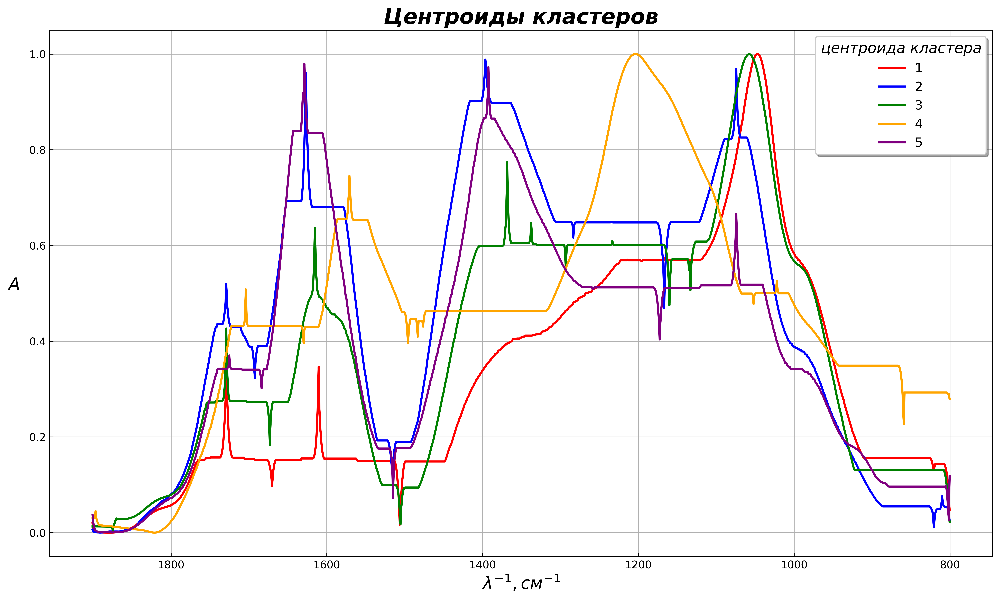

In [264]:
plot_centroids(data=clust_data_dtw,
               n_clusters=5,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/5_clusters/dtw_centroids_5',
               style='default',
               dpi=600)

In [265]:
%%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=5,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/5_clusters/clust_5',
                    dpi=600,
                    show='n')

Кластер №1: {1: 0.8333, 0: 0.1667}
Кластер №2: {1: 0.1429, 2: 0.8571}
Кластер №3: {1: 0.3333, 2: 0.6667}
Кластер №4: {0: 1.0}
Кластер №5: {2: 1.0}
CPU times: user 1min 16s, sys: 16.1 s, total: 1min 32s
Wall time: 49.2 s


,cluster_label,class,short_descr
3,1,1,$GO$
8,1,1,$GO$
9,1,1,$GO$
10,1,0,$rGO$
11,1,1,$GO$
13,1,1,$GO$
2,2,1,$GO$
28,2,2,$GO_{d}$
24,2,2,$GO_{d}$
23,2,2,$GO_{d}$


### Число кластеров — 6

In [ ]:
plot_centroids(data=data_spectra,
               n_clusters=6,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/6_clusters/dtw_centroids_6',
               style='default',
               dpi=600)

In [267]:
# %%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=6,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/6_clusters/clust_6',
                    dpi=600,
                    show='n')

Кластер №1: {1: 0.8333, 0: 0.1667}
Кластер №2: {1: 0.1667, 2: 0.8333}
Кластер №3: {1: 0.4, 2: 0.6}
Кластер №4: {0: 1.0}
Кластер №5: {2: 1.0}
Кластер №6: {2: 1.0}


,cluster_label,class,short_descr
3,1,1,$GO$
8,1,1,$GO$
9,1,1,$GO$
10,1,0,$rGO$
11,1,1,$GO$
13,1,1,$GO$
2,2,1,$GO$
28,2,2,$GO_{d}$
24,2,2,$GO_{d}$
23,2,2,$GO_{d}$


### Число кластеров — 7

  0%|          | 0/7 [00:00<?, ?it/s]

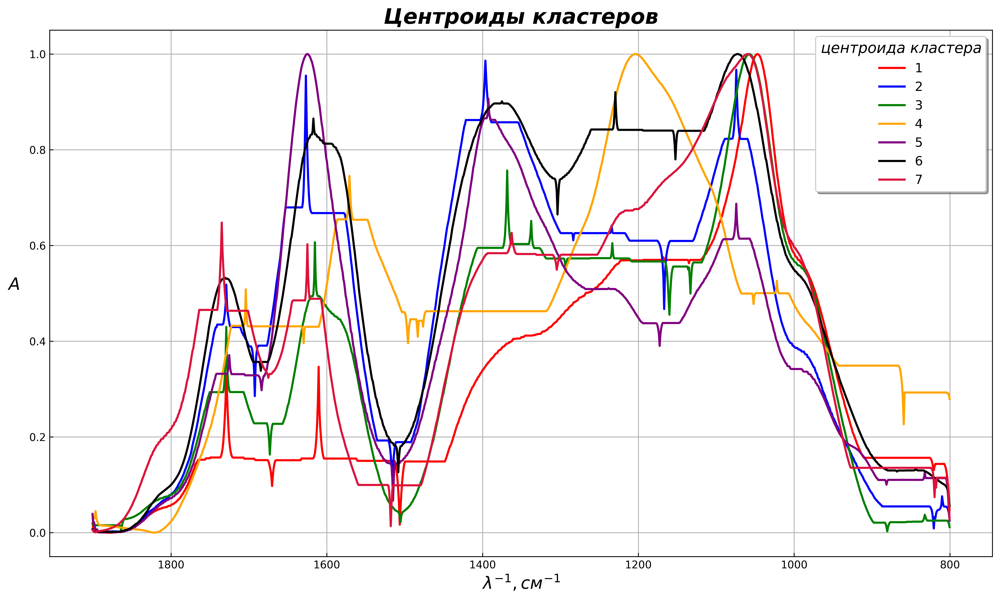

In [268]:
plot_centroids(data=clust_data_dtw,
               n_clusters=7,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/7_clusters/dtw_centroids_7',
               style='default',
               dpi=600)

In [269]:
# %%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=7,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/7_clusters/clust_7',
                    dpi=600,
                    show='n')

Кластер №1: {1: 0.8333, 0: 0.1667}
Кластер №2: {1: 0.1429, 2: 0.8571}
Кластер №3: {2: 1.0}
Кластер №4: {0: 1.0}
Кластер №5: {2: 1.0}
Кластер №6: {2: 1.0}
Кластер №7: {1: 1.0}


,cluster_label,class,short_descr
13,1,1,$GO$
3,1,1,$GO$
8,1,1,$GO$
9,1,1,$GO$
10,1,0,$rGO$
11,1,1,$GO$
2,2,1,$GO$
24,2,2,$GO_{d}$
23,2,2,$GO_{d}$
28,2,2,$GO_{d}$


### Число кластеров — 8

  0%|          | 0/8 [00:00<?, ?it/s]

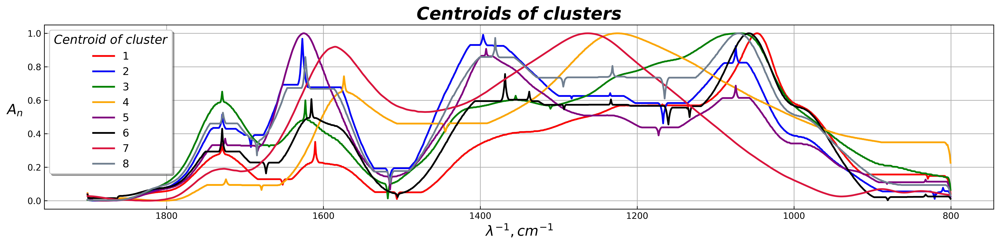

In [84]:
plot_centroids(data=data_spectra,
               n_clusters=8,
               metric='dtw',
               figsize=(16, 4),
               save='y',
               name_of_file=path_to_save + '/8_clusters/dtw_centroids_8',
               style='default',
               dpi=600)

In [271]:
# %%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=8,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/8_clusters/clust_8',
                    dpi=600,
                    show='n')

Кластер №1: {1: 1.0}
Кластер №2: {1: 0.2, 2: 0.8}
Кластер №3: {1: 1.0}
Кластер №4: {0: 1.0}
Кластер №5: {2: 1.0}
Кластер №6: {2: 1.0}
Кластер №7: {0: 1.0}
Кластер №8: {2: 1.0}


,cluster_label,class,short_descr
3,1,1,$GO$
8,1,1,$GO$
9,1,1,$GO$
11,1,1,$GO$
13,1,1,$GO$
2,2,1,$GO$
23,2,2,$GO_{d}$
20,2,2,$GO_{d}$
28,2,2,$GO_{d}$
24,2,2,$GO_{d}$


### Число кластеров — 9

  0%|          | 0/9 [00:00<?, ?it/s]

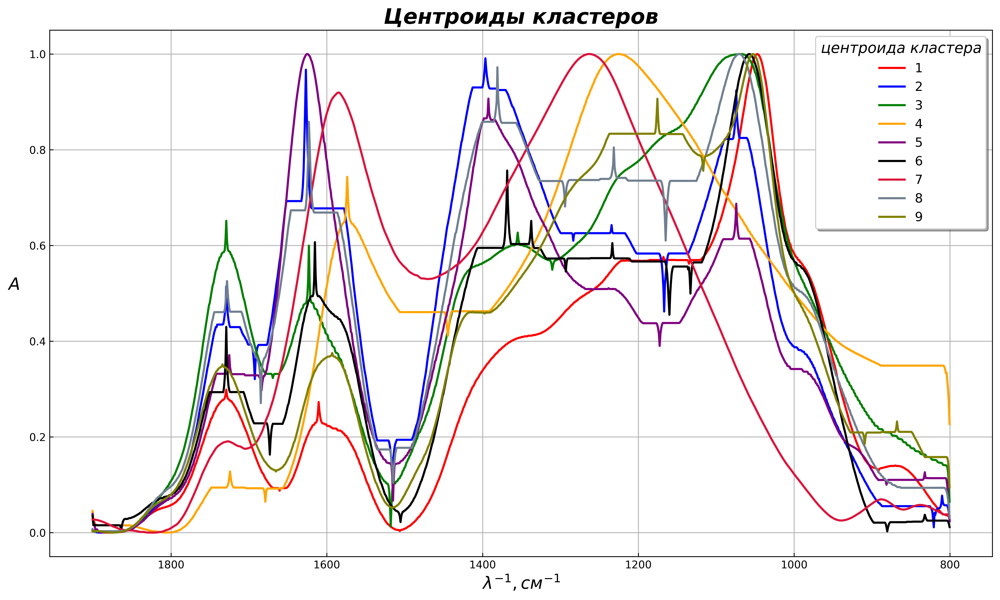

In [272]:
plot_centroids(data=clust_data_dtw,
               n_clusters=9,
               metric='dtw',
               save='y',
               name_of_file=path_to_save + '/9_clusters/dtw_centroids_9',
               style='default',
               dpi=600)

In [273]:
# %%time
ts_cluster_analysis(data=clust_data_dtw,
                    info=descr_data_dtw,
                    n_clusters=9,
                    metric='dtw',
                    save='y',
                    name_of_file=path_to_save + '/9_clusters/clust_9',
                    dpi=600,
                    show='n')

Кластер №1: {1: 1.0}
Кластер №2: {2: 0.8, 1: 0.2}
Кластер №3: {1: 1.0}
Кластер №4: {0: 1.0}
Кластер №5: {2: 1.0}
Кластер №6: {2: 1.0}
Кластер №7: {0: 1.0}
Кластер №8: {2: 1.0}
Кластер №9: {1: 1.0}


,cluster_label,class,short_descr
11,1,1,$GO$
9,1,1,$GO$
8,1,1,$GO$
20,2,2,$GO_{d}$
24,2,2,$GO_{d}$
28,2,2,$GO_{d}$
23,2,2,$GO_{d}$
2,2,1,$GO$
12,3,1,$GO$
1,3,1,$GO$


# Дополнительно

In [ ]:
sizes = list(map(lambda x: x / 26, [3, 12, 2, 4, 3, 2]))
labels= ['$GO$', '$GO_{диализ}$', '$GO$', '$rGO$', '$GO_{диализ}$', '$GO$']
explode = 0.01

fig = plt.figure(figsize=(6, 6), linewidth=1.0, dpi=150)
ax = fig.gca()

ax.pie(x=sizes,
       labels=labels,
       autopct='%1.1f%%',
       textprops={'fontsize':16},
       colors=sns.color_palette('Set2'),
       explode=[explode] * 6)
plt.savefig(path_to_save + '/6_clusters/pie_chart.png', dpi=600)
plt.show()

In [ ]:
sizes = list(map(lambda x: x / 26, [5, 5, 3, 3, 3, 2, 1, 4]))
labels= ['$GO$', '$GO_{диализ}$', '$GO$', '$rGO$', '$GO_{диализ}$', '$GO_{диализ}$', '$rGO$', '$GO_{диализ}$']
explode = 0.01

fig = plt.figure(figsize=(6, 6), linewidth=1.0, dpi=150)
ax = fig.gca()

ax.pie(x=sizes,
       labels=labels,
       autopct='%1.1f%%',
       textprops={'fontsize':18},
       colors=sns.color_palette('Set2'),
       explode=[explode] * 8)
# plt.savefig(path_to_save + '/8_clusters/pie_chart.png', dpi=600)
plt.show()